# Análisis de Datos de Viajes en Bicicletas Públicas en la Ciudad de Buenos Aires

En este informe, se presenta un análisis detallado de los datos de viajes en bicicletas públicas en la Ciudad de Buenos Aires. El objetivo principal es modelar los viajes como una red y proporcionar visualizaciones intuitivas para entender las características clave de los datos.

In [1]:
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
import seaborn as sns

## Exploración de datos

Primero, cargo los datos desde el archivo CSV proporcionado. El conjunto de datos contiene información sobre los recorridos de bicicletas públicas, incluyendo la duración del recorrido, ubicación de estaciones, fecha y hora, entre otros.

In [2]:
df = pd.read_csv('trips_2023.csv', parse_dates=['fecha_origen_recorrido', 'fecha_destino_recorrido'])

df.head()

,Unnamed: 0,Id_recorrido,duracion_recorrido,fecha_origen_recorrido,id_estacion_origen,nombre_estacion_origen,direccion_estacion_origen,long_estacion_origen,lat_estacion_origen,fecha_destino_recorrido,id_estacion_destino,nombre_estacion_destino,direccion_estacion_destino,long_estacion_destino,lat_estacion_destino,id_usuario,modelo_bicicleta,género
0,1,17910696BAEcobici,"1,848",2023-04-24 10:30:10,358BAEcobici,249 - Balbín,2519 Conesa,-58.465586,-34.561486,2023-04-24 11:00:58,278BAEcobici,233 - MONROE,2519 Superi,-58.469813,-34.564122,861866BAEcobici,ICONIC,MALE
1,2,17600256BAEcobici,288,2023-03-22 17:40:55,444BAEcobici,061 - Ministerio de Economia,"Balcarce e Yrigoyen, Hipolito Av.",-58.370716,-34.608936,2023-03-22 17:45:43,3BAEcobici,003 - ADUANA,Moreno & Azopardo,-58.368174,-34.611102,217525BAEcobici,ICONIC,FEMALE
2,3,17255670BAEcobici,"1,103",2023-02-15 23:12:22,280BAEcobici,222 - SIMON BOLIVAR,"1701 Fernandez Moreno, Baldomero",-58.449379,-34.633528,2023-02-15 23:30:45,280BAEcobici,222 - SIMON BOLIVAR,"1701 Fernandez Moreno, Baldomero",-58.449379,-34.633528,954201BAEcobici,ICONIC,MALE
3,4,17996972BAEcobici,"1,165",2023-05-03 11:00:20,273BAEcobici,223 - GAINZA,"494 Gainza, Martin De, Gral.",-58.446751,-34.616758,2023-05-03 11:19:45,367BAEcobici,287 - Belaustegui,"Belaustegui, Luis, Dr. 2890",-58.477209,-34.616212,179414BAEcobici,ICONIC,MALE
4,5,17148836BAEcobici,378,2023-02-06 06:50:58,65BAEcobici,065 - Julián Álvarez,3822 Guemes,-58.415787,-34.587312,2023-02-06 06:57:16,14BAEcobici,014 - Pacifico,"Santa Fe Av. & Bullrich, Int. Av.",-58.426387,-34.577424,8098BAEcobici,ICONIC,MALE


### Rutas más frecuentes:

Identifico las rutas más frecuentes en función de la cantidad de veces que son recorridas.

In [6]:
frecuencia_rutas = df.groupby(['nombre_estacion_origen', 'nombre_estacion_destino']).size().reset_index(name='frecuencia')

rutas_mas_frecuentes = frecuencia_rutas.sort_values(by='frecuencia', ascending=False).head(5)

print(rutas_mas_frecuentes[['nombre_estacion_origen', 'nombre_estacion_destino', 'frecuencia']])

         nombre_estacion_origen           nombre_estacion_destino  frecuencia
1241             014 - Pacifico  391 - Plaza República de Ecuador        2014
24660           393 - Barrio 31                   130 - RETIRO II        1950
10341           130 - RETIRO II               237 - Madero Office        1866
2224        026 - JUANA MANSO I                   130 - RETIRO II        1861
23002  352 - San Jose de Flores                     206 - Galicia        1803


### Cantidad de viajes según género
El gráfico muestra la distribución de género en los viajes en bicicleta pública en la Ciudad de Buenos Aires. Se observa una comparación entre la cantidad de viajes realizados por mujeres y hombres.

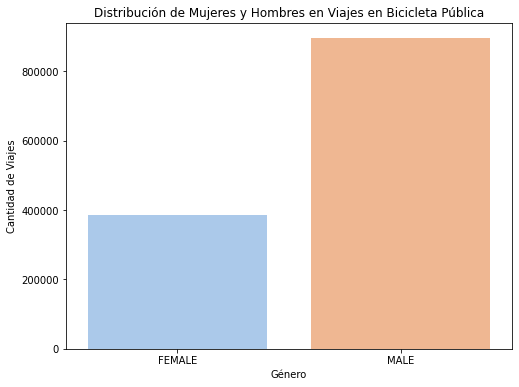

In [7]:
import matplotlib.pyplot as plt
import seaborn as sns

df_genero = df[df['género'].isin(['FEMALE', 'MALE'])]

plt.figure(figsize=(8, 6))
sns.countplot(x='género', data=df_genero, palette='pastel')
plt.title('Distribución de Mujeres y Hombres en Viajes en Bicicleta Pública')
plt.xlabel('Género')
plt.ylabel('Cantidad de Viajes')
plt.show()


## Análisis geoespacial

### Actividad por área
Usando el siguiente mapa de calor se pueden identificar las áreas de la ciudad con mayor actividad.

In [8]:
import folium
from folium.plugins import HeatMap

mapa_calor = folium.Map(location=[-34.61, -58.38], zoom_start=13)

HeatMap(df[['lat_estacion_origen', 'long_estacion_origen']].values).add_to(mapa_calor)

mapa_calor


## Análisis temporal

### Duración promedio de los viajes

In [ ]:
duracion_promedio = df['duracion_recorrido'].mean()
print(f'Duración promedio de los viajes: {duracion_promedio} minutos')

### Distribución de duración de los viajes

Esto proporciona una visión sobre cómo se distribuyen las duraciones de los recorridos en la red de bicicletas públicas.

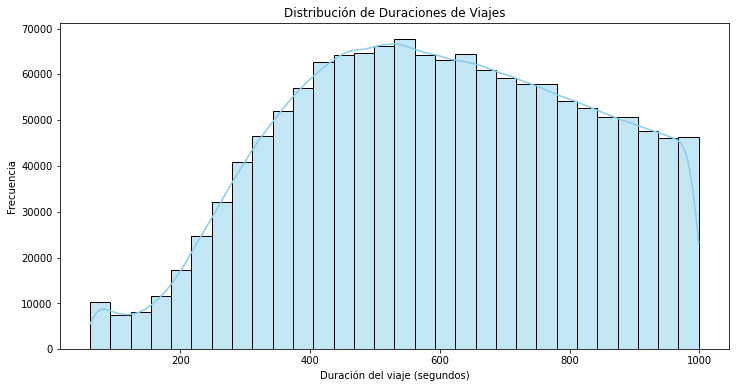

In [55]:
plt.figure(figsize=(12, 6))
sns.histplot(df['duracion_recorrido'].dropna(), bins=30, kde=True, color='skyblue')
plt.title('Distribución de Duraciones de Viajes')
plt.xlabel('Duración del viaje (segundos)')
plt.ylabel('Frecuencia')
plt.show()


### Cantidad de viajes por mes

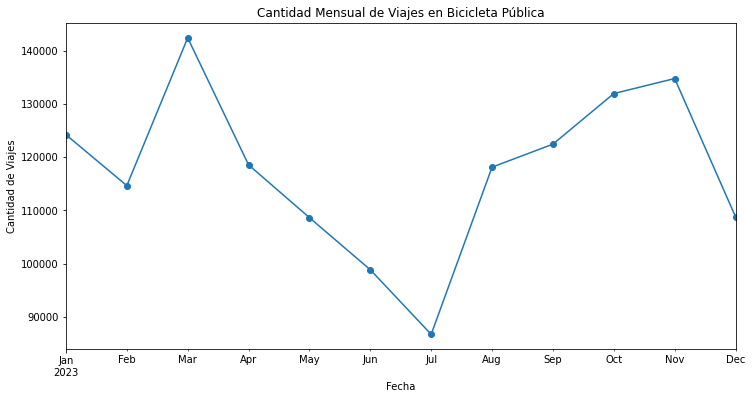

In [56]:
viajes_por_mes = df.resample('M', on='fecha_origen_recorrido').size()

plt.figure(figsize=(12, 6))
viajes_por_mes.plot(marker='o')
plt.title('Cantidad Mensual de Viajes en Bicicleta Pública')
plt.xlabel('Fecha')
plt.ylabel('Cantidad de Viajes')
plt.show()


### Horas pico: 
Identificar las horas del día con mayor y menor demanda de bicicletas públicas.

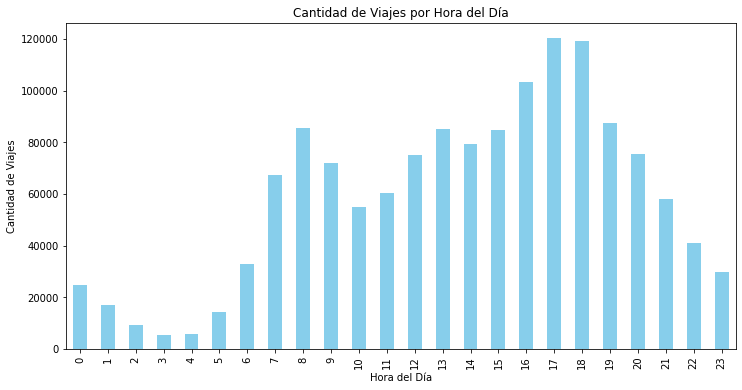

In [57]:
df['hora_del_dia'] = df['fecha_origen_recorrido'].dt.hour

viajes_popr_hora = df['hora_del_dia'].value_counts().sort_index()

plt.figure(figsize=(12, 6))
viajes_popr_hora.plot(kind='bar', color='skyblue')
plt.title('Cantidad de Viajes por Hora del Día')
plt.xlabel('Hora del Día')
plt.ylabel('Cantidad de Viajes')
plt.show()


## Modelado de los viajes como una red

Utilizo la biblioteca `NetworkX` para modelar los viajes como un multigrafo dirigido. Cada estación de bicicletas se representa como un nodo, y las conexiones entre estaciones se definen como aristas ponderadas por la duración del recorrido.

In [53]:
# Limpiar los datos eliminando filas con valores no numéricos y filas con valores nan.
df = df[pd.to_numeric(df['duracion_recorrido'], errors='coerce').notnull()]
df = df.dropna(subset=['nombre_estacion_origen', 'nombre_estacion_destino', 'duracion_recorrido'])

G = nx.DiGraph()

for index, row in df.iterrows():
    G.add_edge(row['nombre_estacion_origen'], row['nombre_estacion_destino'], weight=row['duracion_recorrido'])

Calculo la cantidad de nodos, de aristas y la densidad de la red para tener una idea de qué tan iterconectada está.

In [61]:
num_nodos = len(G.nodes)
num_aristas = len(G.edges)
densidad_red = nx.density(G)


print(f'Número de nodos en la red: {num_nodos}')
print(f'Número de aristas en la red: {num_aristas}')

# La densidad es el número de aristas presentes en relación con el número total posible de aristas.
print(f'Densidad de la red: {densidad_red}')

Número de nodos en la red: 366
Número de aristas en la red: 24920
Densidad de la red: 0.186540908750655


### Estaciones más comunes

A continuación se muestran las estaciones de bicicletas con mayor grado de salida (es decir, de las que parten más ciclistas) y las estaciones con mayor grado de entrada (a las que llegan más ciclistas).

In [68]:
estaciones_mas_salidas = sorted(G.out_degree, key=lambda x: x[1], reverse=True)
print("Estaciones con más salidas:")
for station, out_degree in estaciones_mas_salidas[:5]:
    print(f"{station}: {out_degree}")

estaciones_mas_entradas = sorted(G.in_degree, key=lambda x: x[1], reverse=True)
print("\nEstaciones con más entradas:")
for station, in_degree in estaciones_mas_entradas[:5]:
    print(f"{station}: {in_degree}")



Estaciones con más salidas:
131- HOSPITAL DE CLÍNICAS: 126
054 - Acuña de Figueroa: 125
008 - Congreso: 125
161 - Humahuaca: 123
033 - Facultad de Medicina: 122

Estaciones con más entradas:
054 - Acuña de Figueroa: 128
131- HOSPITAL DE CLÍNICAS: 117
163 - ONCE II: 116
033 - Facultad de Medicina: 116
008 - Congreso: 116


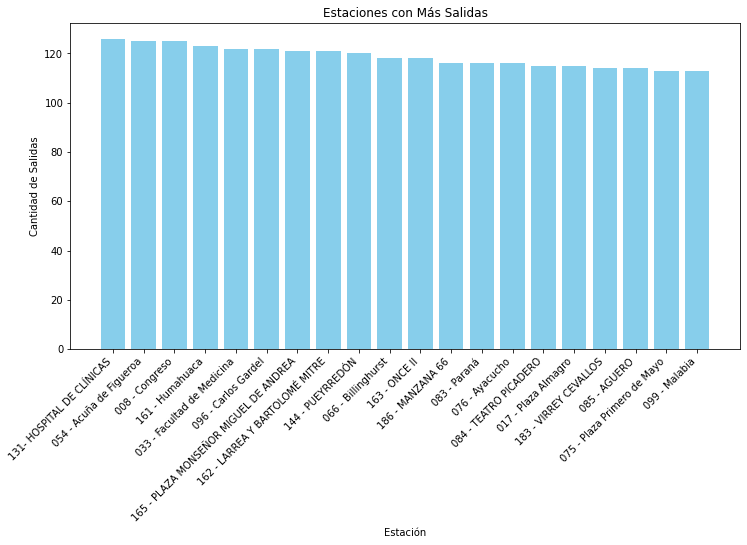

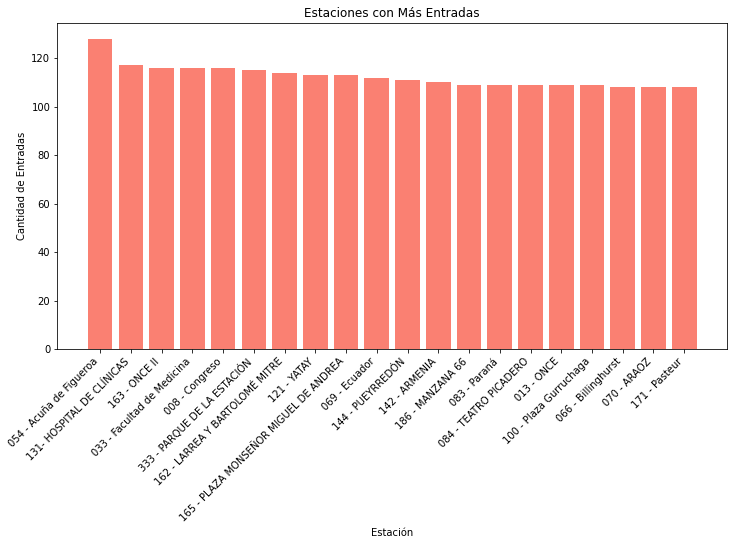

In [73]:
plt.figure(figsize=(12, 6))
plt.bar([station[0] for station in estaciones_mas_salidas[:20]], [station[1] for station in estaciones_mas_salidas[:20]], color='skyblue')
plt.title('Estaciones con Más Salidas')
plt.xlabel('Estación')
plt.ylabel('Cantidad de Salidas')
plt.xticks(rotation=45, ha='right')
plt.show()

plt.figure(figsize=(12, 6))
plt.bar([station[0] for station in estaciones_mas_entradas[:20]], [station[1] for station in estaciones_mas_entradas[:20]], color='salmon')
plt.title('Estaciones con Más Entradas')
plt.xlabel('Estación')
plt.ylabel('Cantidad de Entradas')
plt.xticks(rotation=45, ha='right')
plt.show()

Las siguientes son las estaciones menos frecuentes, las que tienen menor grado de salida y las que tienen menor grado de entrada.

In [75]:
estaciones_menos_salidas = sorted(G.out_degree, key=lambda x: x[1])
print("Estaciones con menos salidas:")
for station, out_degree in estaciones_menos_salidas[:5]:
    print(f"{station}: {out_degree}")

estaciones_menos_entradas = sorted(G.in_degree, key=lambda x: x[1])
print("\nEstaciones con menos entradas:")
for station, in_degree in estaciones_menos_entradas[:5]:
    print(f"{station}: {in_degree}")


Estaciones con menos salidas:
291 - REPARACION DE K7: 0
-CDO BARRACAS-: 2
134 - SOLDADO DE LA FRONTERA: 5
356 - ESTACIÓN LUGANO: 6
271 - VILLA SOLDATI II: 6

Estaciones con menos entradas:
291 - REPARACION DE K7: 1
-CDO BARRACAS-: 2
180 - PARQUE OLIMPICO: 3
389 - Plaza República De Mexico: 4
271 - VILLA SOLDATI II: 5


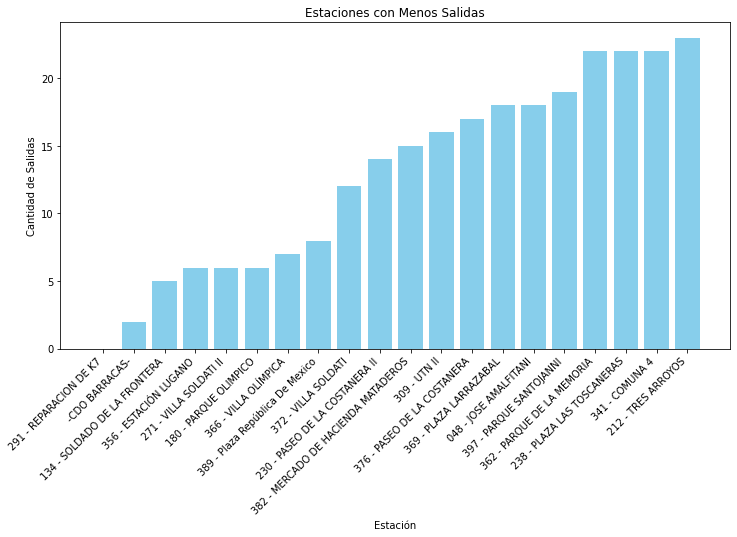

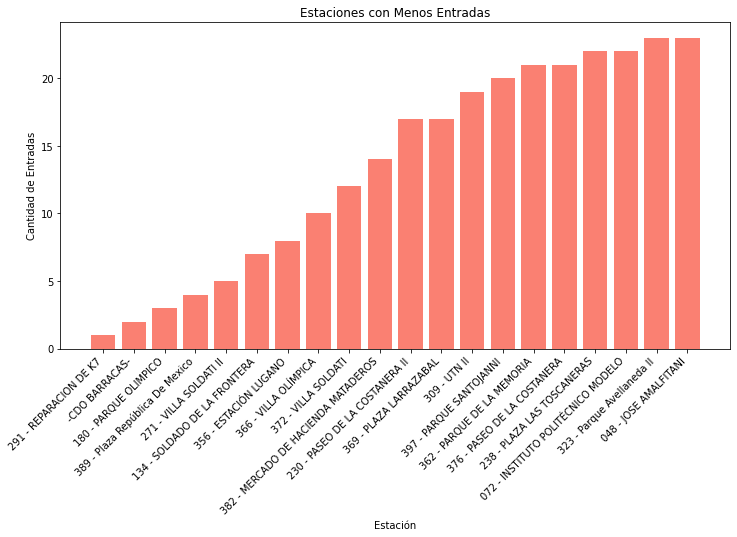

In [76]:
plt.figure(figsize=(12, 6))
plt.bar([station[0] for station in estaciones_menos_salidas[:20]], [station[1] for station in estaciones_menos_salidas[:20]], color='skyblue')
plt.title('Estaciones con Menos Salidas')
plt.xlabel('Estación')
plt.ylabel('Cantidad de Salidas')
plt.xticks(rotation=45, ha='right')
plt.show()

plt.figure(figsize=(12, 6))
plt.bar([station[0] for station in estaciones_menos_entradas[:20]], [station[1] for station in estaciones_menos_entradas[:20]], color='salmon')
plt.title('Estaciones con Menos Entradas')
plt.xlabel('Estación')
plt.ylabel('Cantidad de Entradas')
plt.xticks(rotation=45, ha='right')
plt.show()